DSC160 Data Science and the Arts - Twomey - Spring 2020 - [dsc160.roberttwomey.com](http://dsc160.roberttwomey.com)

# Exercise 2: Audio Classification with MFCCs

This exercise walks you through feature extraction and genre classification based on MFCCs, using audio frames extracted from two instances of distinct audio styles (classical and rap music).

It has two parts:
- [Part 1](#Part-1:-Genre-Recognition). In this part you will load two audio files as genre examples, extract MFCC features from each, and implement a simple SVM classifier.
  - [Step 1 - Load Files and Display Audio](#Step-1:-Load-Files-and-Display-Audio)
  - [Step 2 - Extract Features](#Step-2:-Extract-Features)
  - [Step 3 - Train a Classifier](#Step-3:-Train-a-Classifier)
  - [Step 4 - Run the Classifier](#Step-4:-Run-the-Classifier)
- [Part 2](#Part-2:-Extension). In this part you will extend the work from Part 1, either creating a new classifier using new genre examples and training examples from your own music collection, implementing a new classifier method, or experimenting with different features for the SVM and existing examples.
  - [Part 2A - Code for your Extension](#2A.-Code-for-Extension)
  - [Part 2B - Discussion of Results](#2B.-Discussion-of-Results)
  
Once you have completed both parts, you will submit your completed notebook as a pdf to gradescope for grading.

Note: this is a simplified genre classification example. For a more comprehensive approach combining timbral, beat, and pitch features, see Tzanetakis and Cook ['Musical Genre Classification of Audio Signal'](https://pdfs.semanticscholar.org/4ccb/0d37c69200dc63d1f757eafb36ef4853c178.pdf) from IEEE Transactions on Audio and Speech Processing 2002. Many of the techniques described in that paper can be implemented using librosa and our numpy/scipy toolkits for your own Project 1.

## Setup

Import necessary modules:

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import seaborn

import librosa
import librosa.display

from IPython.display import Audio

import requests
import os

import sklearn
import numpy as np

import pandas as pd

## Part 1: Genre Recognition
(50 points total)

This section walks you through three steps: 
1. Load and Display Audio Files
2. Extracting features from an audio signal.
3. Training a genre classifier.
4. Using the classifier to classify the genre in a song.

### Step 1: Load Files and Display Audio
(10 points)

We will use two audio pieces as exemplars of distinct audio genres:

- Johannes Brahms' ['Hungarian Dance #5 in G Minor'](https://www.youtube.com/watch?v=3X9LvC9WkkQ) (1885) 
- Busta Rhmyes' ['Hits for Days feat. J Holiday'](https://www.youtube.com/watch?v=B6bt3gWLV5g) (2016) 
  
These have both been added to the course repository in an `audio` subdirectory under the current path:
- `audio/brahms_hungarian_dance_5.mp3`
- `audio/busta_rhymes_hits_for_days.mp3`

Using [`librosa.load`](https://librosa.github.io/librosa/generated/librosa.core.load.html), load 120 seconds of Brahms :

In [2]:
# your code here
# load
# librosa.core.load(path, sr=22050, mono=True, offset=0.0, duration=120.0, dtype=<class 'numpy.float32'>, res_type='kaiser_best')
x, fs = librosa.load("audio/brahms_hungarian_dance_5.mp3")

/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


Using `librosa.display.waveplot`, plot the time-domain waveform of the audio signal for Brahms:

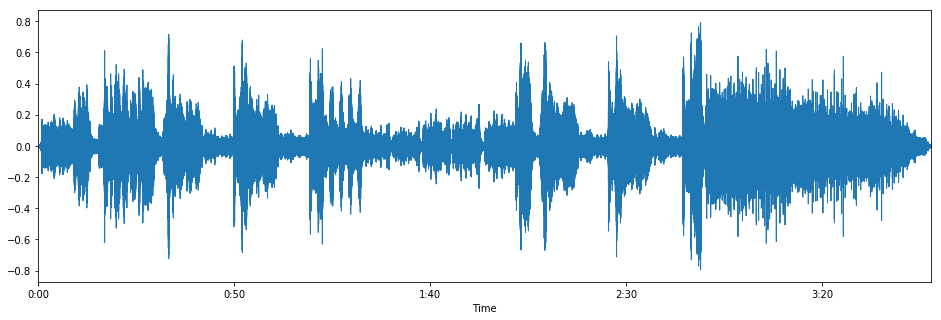

In [3]:
# your code here
# display
plt.figure(figsize=(16, 5))
librosa.display.waveplot(x, sr=fs)
plt.show()

Using the IPython.display Audio class, play the audio file:

In [4]:
# your code here
# play
Audio(x, rate=fs)

Using [`librosa.feature.melspectogram`](https://librosa.github.io/librosa/generated/librosa.feature.melspectrogram.html), [`librosa.power_to_db`](https://librosa.github.io/librosa/generated/librosa.core.power_to_db.html), and [`librosa.display.specshow`](https://librosa.github.io/librosa/generated/librosa.display.specshow.html), calculate and display the mel spectogram with a logarithmic magnitude scale:

In [5]:
# calculate mel spectogram

# librosa.feature.melspectrogram(y=None, sr=22050, S=None, n_fft=2048, hop_length=512, 
# win_length=None, window='hann', center=True, pad_mode='reflect', power=2.0, **kwargs)
S = librosa.feature.melspectrogram(y=x, sr=fs, n_mels=128, fmax=8000)

# convert spectogram to log spectogram with power_to_db
plt.figure(figsize=(10, 4))

S_dB = librosa.power_to_db(S, ref=np.max)

<Figure size 720x288 with 0 Axes>

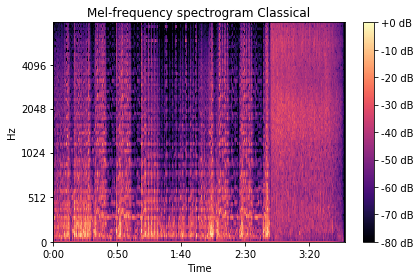

In [6]:
# show spectogram
librosa.display.specshow(S_dB, x_axis='time',
                          y_axis='mel', sr=fs,
                          fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram Classical')
plt.tight_layout()
plt.show()

Repeat the above steps for the Busta Rhymes song. 

Load the file:

In [7]:
# your code here
# load
# librosa.core.load(path, sr=22050, mono=True, offset=0.0, duration=120.0, dtype=<class 'numpy.float32'>, res_type='kaiser_best')
x2, fs2 = librosa.load("audio/busta_rhymes_hits_for_days.mp3")

/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


Display the waveform:

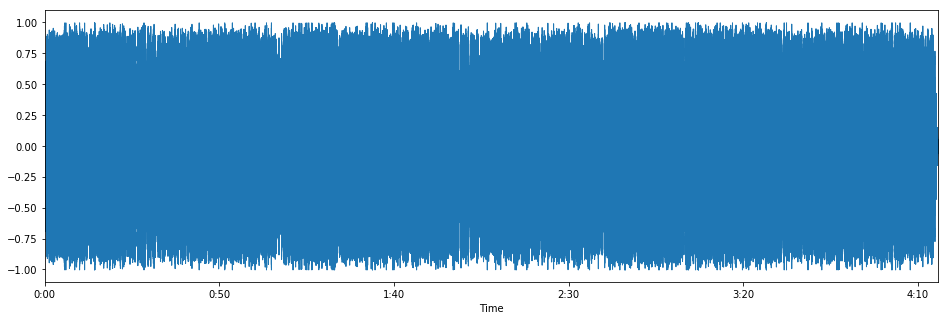

In [8]:
# your code here
# display
plt.figure(figsize=(16, 5))
librosa.display.waveplot(x2, sr=fs2)
plt.show()

Play the audio file:

In [9]:
# your code here
# play
Audio(x2, rate=fs2)

Calculate and display the mel spectogram with a logarithmic magnitude scale:

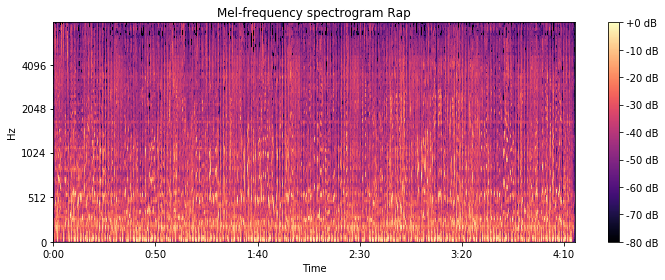

In [10]:
# calculate

# librosa.feature.melspectrogram(y=None, sr=22050, S=None, n_fft=2048, hop_length=512, 
# win_length=None, window='hann', center=True, pad_mode='reflect', power=2.0, **kwargs)
S2 = librosa.feature.melspectrogram(y=x2, sr=fs2, n_mels=128, fmax=8000)

# convert spectogram to log spectogram with power_to_db
plt.figure(figsize=(10, 4))

S_dB2 = librosa.power_to_db(S2, ref=np.max)

# display

# show spectogram
librosa.display.specshow(S_dB2, x_axis='time',
                          y_axis='mel', sr=fs2,
                          fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram Rap')
plt.tight_layout()
plt.show()

Do you notice any difference between the wave form or spectogram for the classical and rap song? Is so, what? 

```We can see that the time domain and MFCC Spectrogram interpretations both concur: the rap song has consistent dynamics and overall monotone spectral bandwidth; meanwhile, the classical song has wide dynamic and spectral contrast.```

### Step 2: Extract Features

(10 points)

We are going to work with MFCCs. For each of your audio files (starting with Brahms), use [`librosa.feature.mfcc`](https://librosa.github.io/librosa/generated/librosa.feature.mfcc.html) to calculate the MFCCs.

(Note: you can experiment with `n_mfcc` to select a different number of coefficients, e.g. 12)

Start with Brahms, using 12 coefficients, inputting the Brahms time series and Brahms sample rate as the arguments to the mfcc function.

In [11]:
# your code here
mfcc_brahms = librosa.feature.mfcc(x, sr=fs, n_mfcc= 12)

print(mfcc_brahms.shape)

(12, 9813)


Note: We transpose the result to accommodate scikit-learn which assumes that each row is one observation, and each column is one feature dimension:

In [12]:
mfcc_brahms = mfcc_brahms.T
mfcc_brahms.shape

(9813, 12)

Using [`sklearn.preprocessing.StandardScaler`](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html), scale the features to have zero mean and unit variance:

In [13]:
# your code here
mfcc_brahms_scaled = sklearn.preprocessing.scale(mfcc_brahms, axis=1)
print("mean:", mfcc_brahms.mean(axis=1))
print("var:", mfcc_brahms.var(axis=1))

mean: [-45.102634 -45.102634 -45.102634 ... -38.1758   -42.398346 -45.102634]
var: [22376.727 22376.727 22376.727 ... 22311.646 22387.28  22376.727]


/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:176: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:193: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


Verify that the scaling worked (e.g. do we have a mean close to zero and std deviation close to 1 for each feature?):

In [14]:
mfcc_brahms_scaled.mean(axis=0)

array([-2.7021496 ,  1.4850075 , -0.32755935,  0.84054697, -0.15072   ,
        0.5267297 , -0.18056618,  0.3121681 , -0.08774982,  0.18428804,
       -0.01073836,  0.11074335], dtype=float32)

In [15]:
mfcc_brahms_scaled.std(axis=0)

array([0.41949978, 0.4004445 , 0.53919685, 0.2547327 , 0.32212284,
       0.35751742, 0.31469104, 0.2487146 , 0.20081443, 0.16671778,
       0.12930144, 0.16050234], dtype=float32)

Repeat these calculations for Busta Rhymes. Use [`librosa.feature.mfcc`](https://librosa.github.io/librosa/generated/librosa.feature.mfcc.html) to calculate the MFCCs, inputting the Busta time series and Busta sample rate as the arguments to the mfcc function.

In [16]:
# your code here
mfcc_busta = librosa.feature.mfcc(x2, sr=fs2, n_mfcc= 12)
print(mfcc_busta.shape)

(12, 11010)


Note: Transpose the result to accommodate scikit-learn which assumes that each row is one observation, and each column is one feature dimension:

In [17]:
mfcc_busta = mfcc_busta.T
mfcc_busta.shape

(11010, 12)

Scale the resulting MFCC features to have approximately zero mean and unit variance. Re-use the scaler from above.

In [18]:
# your code here
mfcc_busta_scaled = sklearn.preprocessing.scale(mfcc_busta, axis=1)
print("mean:", mfcc_busta.mean(axis=1))
print("var:", mfcc_busta.var(axis=1))

mean: [-40.633343 -40.743507 -34.258766 ... -27.487854 -38.518185 -40.633343]
var: [18161.752 17844.025 14023.614 ... 12468.642 18128.174 18161.752]


/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:176: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:193: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


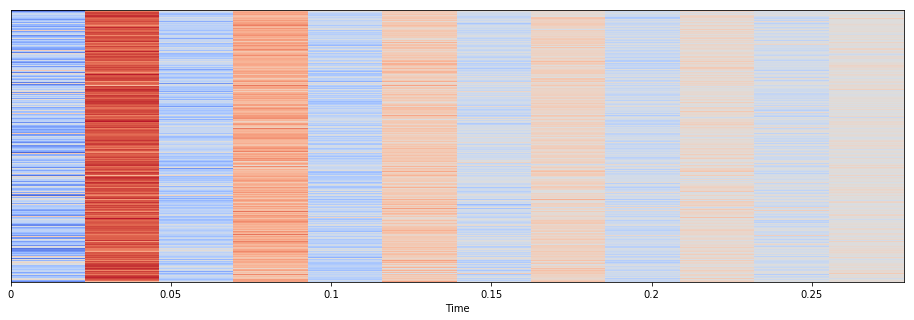

In [19]:
plt.figure(figsize=(16, 5))
librosa.display.specshow(mfcc_busta_scaled, sr=fs, x_axis='time')
plt.show()

Verify that the mean of the MFCCs for the second audio file is approximately equal to zero and the variance is approximately equal to one.

In [20]:
mfcc_busta_scaled.mean(axis=0)

array([-1.1790885 ,  2.3167968 , -0.882112  ,  1.1216061 , -0.79567397,
        0.5178563 , -0.49934474,  0.2656872 , -0.5290572 ,  0.09476318,
       -0.39094836, -0.04047994], dtype=float32)

In [21]:
mfcc_busta_scaled.std(axis=0)

array([0.7769279 , 0.35113528, 0.4043767 , 0.34264755, 0.3684824 ,
       0.27207074, 0.29368624, 0.22680663, 0.24548404, 0.19357051,
       0.24284366, 0.17168322], dtype=float32)

### Step 3: Train a Classifier

(15 points)

Concatenate all of the scaled feature vectors into one feature table using [`np.vstack`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.vstack.html).

In [22]:
# your code here
# stack mfcc_busta_scaled and mfcc_brahms_scaled, probably brahms on top, vertically.
# mfcc_brahms_scaled = mfcc_brahms_scaled.T
# mfcc_busta_scaled = mfcc_busta_scaled.T

#mfcc_brahms_scaled.shape

features = np.vstack((mfcc_brahms_scaled, mfcc_busta_scaled))

In [23]:
features.shape

(20823, 12)

Construct a vector of ground-truth labels using [`np.concatenate`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.concatenate.html), where 0 refers to the first audio file, and 1 refers to the second audio file. (use `np.zeros` and `np.ones` for brahms and busta rhymes)

In [24]:
labels = np.concatenate((np.zeros(len(mfcc_brahms_scaled)), np.ones(len(mfcc_busta_scaled))))
labels.shape

(20823,)

Create a classifer model object using sklearn's Support Vector Machine [`sklearn.svm.SVC`](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html):

In [25]:
# Support Vector Machine
model = sklearn.svm.SVC()

Train the classifier with your test data and labels using [`SVC.fit`](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html#sklearn.svm.SVC.fit):

In [26]:
#features v labels 
model.fit(features, labels)

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='rbf', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

### Step 4: Run the Classifier

(15 points)

To test the classifier, we will extract an unused 10-second segment from the earlier audio fields as test excerpts:

In [27]:
x_brahms_test, fs_brahms = librosa.load("audio/brahms_hungarian_dance_5.mp3", duration=10, offset=120)

/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


In [28]:
x_busta_test, fs_busta = librosa.load("audio/busta_rhymes_hits_for_days.mp3", duration=10, offset=120)

/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


Display the waveform and listen to the audio for both of the test excerpts using `librosa.display.waveplot` and 
`Audio`. 

Start with Brahms test (wave plot and audio player):

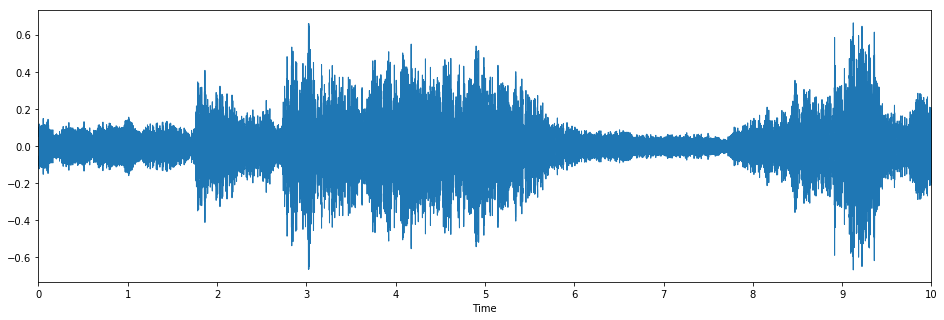

In [29]:
# wave plot
plt.figure(figsize=(16, 5))
librosa.display.waveplot(x_brahms_test, sr=fs_brahms)
plt.show()

# audio playback
Audio(x_brahms_test, rate=fs_brahms)


Next Busta test (waveplot and audio player):

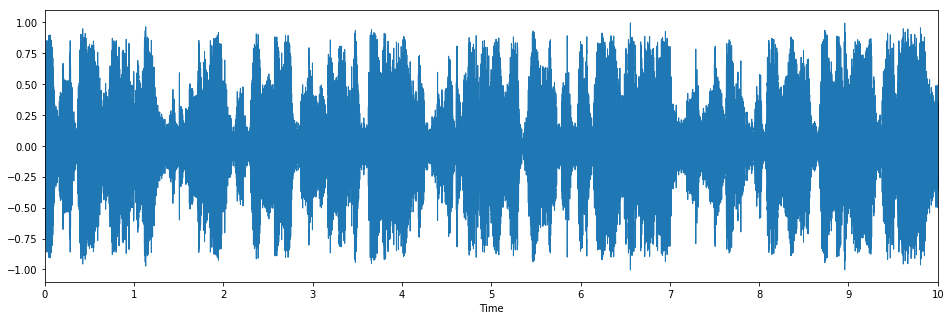

In [30]:
# wave plot

plt.figure(figsize=(16, 5))
librosa.display.waveplot(x_busta_test, sr=fs_busta)
plt.show()

Audio(x_busta_test, rate=fs_busta)
# audio playback

Compute MFCCs from both of the test audio excerpts folowing above using `librosa.feature.mfcc`:

In [31]:
# calculate brahms test mfccs
mfcc_brahms_test = librosa.feature.mfcc(x_brahms_test, sr=fs_brahms, n_mfcc= 12)

In [32]:
# calculate busta rhymes test mfccs
mfcc_busta_test = librosa.feature.mfcc(x_busta_test, sr=fs_busta, n_mfcc= 12)

Scale the test sample MFCCs using the previous scaler:

In [33]:
# your code here
mfcc_busta_test_scaled = sklearn.preprocessing.scale(mfcc_busta_test, axis=1)
mfcc_busta_test_scaled.shape

/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:176: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:193: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


(12, 431)

In [34]:
# your code here
mfcc_brahms_test_scaled = sklearn.preprocessing.scale(mfcc_brahms_test, axis=1)
mfcc_brahms_test_scaled.shape

/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:176: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:193: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


(12, 431)

Concatenate all test features together using `np.vstack`:

In [35]:
test_features = np.vstack((mfcc_brahms_test_scaled.T, mfcc_busta_test_scaled.T))
test_features.shape
#print(test_features)

(862, 12)

Concatenate all test labels together (using `np.concatenate`, with `np.zeros` for brahms and `np.ones` for busta rhymes):

In [36]:
test_labels = np.concatenate((np.zeros(len(mfcc_brahms_test_scaled.T)), np.ones(len(mfcc_busta_test_scaled.T))))
test_labels.shape
print(test_labels.shape)

(862,)


Compute the predicted labels using `model.predict`:

In [37]:
predict_array = model.predict(test_features)
predict_array.shape
print(predict_array.shape)

(862,)


Finally, compute the accuracy score of the classifier on the test data using `model.score`, based on predicted labels and test labels:

In [38]:
# X array-like of shape (n_samples, n_features)
# Test samples.

# y array-like of shape (n_samples,) or (n_samples, n_outputs)
# True labels for X.

# predict_array = predict_array.reshape(1, -1)
# test_labels = test_labels.reshape(1, -1)

# test_labels.shape
#predict_array.shape

#score: return the mean accuracy on the given test data and labels.
#predict([0.58,0.76])
print(model.score( test_features, test_labels))
print(model.score( test_features, predict_array))
#print(output)

0.5
1.0


Do you believe this classifier is performing well? If so, why? If not, why not?

```If I understand what is happening is the model is taking in test_features and test_labels. The model is outputting the label prediction and comparing with test_labels. In the second line we compara the same data with the predicted label array from before. We see our prediction was 100% right. If this is true then the model is not splitting classical and rap. It has compressed the state space.```

## Part 2: Extension
(50 points)

Extend this exercise in some aspect. Possible extension include:
- Find a confounding example (hip hop song that samples classical music), calculate and classify MFCCs. What do you find are the classification results? Plot the label over time.
- Create a new genre classifier by repeating the steps above, but this time use training data and test data from your own audio collection representing two or more different genres. For what genres and audio data styles does the classifier work well, and for which (pairs of) genres does the classifier fail?
- Create a new genre classifier by repeating the steps above, but this time use a different machine learning classifier, e.g. random forest, Gaussian mixture model, Naive Bayes, k-nearest neighbor, etc. Adjust the parameters. How well do they perform?
- Create a new genre classifier by repeating the steps above, but this time use different features. Consult the [librosa documentation on feature extraction](http://librosa.github.io/librosa/feature.html) for different choices of features. Which features work well? not well?

### 2A. Code for Extension

Write your code below with comments (25 points): 

/anaconda3/lib/python3.7/site-packages/librosa/core/audio.py:161: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn('PySoundFile failed. Trying audioread instead.')


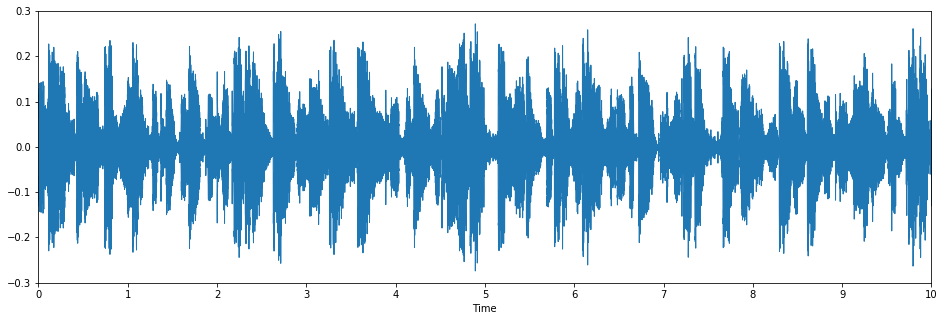

/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:176: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:193: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


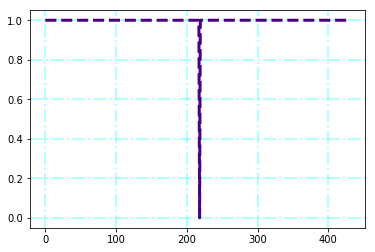

In [39]:
x_nas, fs_nas = librosa.load("audio/nas_i_can.mp3", duration=10, offset=120)

# wave plot
plt.figure(figsize=(16, 5))
librosa.display.waveplot(x_nas, sr=fs_nas)
plt.show()

# audio playback
Audio(x_nas, rate=fs_nas)

# calculate nas mfccs
mfcc_nas = librosa.feature.mfcc(x_nas, sr=fs_nas, n_mfcc= 12)

#scale
mfcc_nas_scaled = sklearn.preprocessing.scale(mfcc_nas, axis=1)
#mfcc_nas_scaled.shape

predict_nas = model.predict(mfcc_nas_scaled.T)
#predict_nas.shape

import numpy as np
import matplotlib.pyplot as plt
fig = plt.figure()

plt.plot(predict_nas, color='Indigo', linestyle='--', linewidth=3)
plt.grid(b=True, color='aqua', alpha=0.3, linestyle='-.', linewidth=2)
plt.show()


### 2B. Discussion of Results

(25 points total)

Describe your goals for the extension (1 paragraph, 10 points):

```I wanted to find a song that was classical and rap at the same time. I chose a song by Nas that samples a classical piano. Unfortunately, from all the frames only one was analyzed as classical (or in the style of brahms), the rest of the song is hip hop. ``` 

Describe your results for the extension (1 paragraph, 10 points):

```By using this information we can objectively say that the song I Can by Nas is more hip hop than classical. My suspicion is that the beat are a lare part of the spectral character of the song```

Describe future directions and interesting research questions for this line of inquiry (1 paragraph, 5 points):

```It would be fun to make a more in depth model that can classify any number of songs. I think it would also be good to know what percentage of a new song is which genre; this might help music producers with marketing. Naturally, these models are great for musicology where we seek to understand patterns in music making techniques for cultural analysis.```

## References
- Tzanetakis and Cook ['Musical Genre Classification of Audio Signals'](https://pdfs.semanticscholar.org/4ccb/0d37c69200dc63d1f757eafb36ef4853c178.pdf) from IEEE Transactions on Audio and Speech Processing 2002.- International Society for Music Information Retrieval (ISMIR) [https://ismir.net/](https://ismir.net/)
- LibROSA [https://librosa.github.io/librosa/](https://librosa.github.io/librosa/)
- SciPy 2015 Talk on Audio / MIR: https://www.youtube.com/watch?v=MhOdbtPhbLU
  - [website](https://bmcfee.github.io/) [paper](https://bmcfee.github.io/papers/scipy2015_librosa.pdf)
- Music Representation: https://musicinformationretrieval.com/audio_representation.html
